In [ ]:
!pip install snscrape

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.8/71.8 KB 3.5 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import snscrape.modules.twitter as sntwitter
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
nltk.download('stopwords')

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.stem.porter import PorterStemmer

import string
import re
import textblob
from textblob import TextBlob
import os

from wordcloud import WordCloud, STOPWORDS
from wordcloud import ImageColorGenerator
import warnings
%matplotlib inline

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


**1. Scrape Twitter Data for Union Budget 2023**

In [ ]:
#using OS library to call CLI command in python
os.system("snscrape --jsonl --max-results 5000 --since 2023-01-31 twitter-search 'Chatgpt until:2023-02-07'>text-query-tweets.json")

0

In [ ]:
#Read the JSON generated from the CLI command above and create a pandas dataframe
tweets_df = pd.read_json("text-query-tweets.json" ,lines=True)

In [ ]:
tweets_df.head(5)

,_type,url,date,rawContent,renderedContent,id,user,replyCount,retweetCount,likeCount,...,cashtags,card,viewCount,vibe,content,outlinks,outlinksss,tcooutlinks,tcooutlinksss,username
0,snscrape.modules.twitter.Tweet,https://twitter.com/Floor_Doughnut/status/1622...,2023-02-06 23:59:57+00:00,mwahahaa alas humanity will surrender to me an...,mwahahaa alas humanity will surrender to me an...,1622746951585259521,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,1,...,None,None,61.0,None,mwahahaa alas humanity will surrender to me an...,[],,[],,Floor_Doughnut
1,snscrape.modules.twitter.Tweet,https://twitter.com/JyotbirLamba/status/162274...,2023-02-06 23:59:56+00:00,@yanatweets @danieljthomason Do you manually p...,@yanatweets @danieljthomason Do you manually p...,1622746948691443717,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,1,...,None,None,101.0,None,@yanatweets @danieljthomason Do you manually p...,[],,[],,JyotbirLamba
2,snscrape.modules.twitter.Tweet,https://twitter.com/Flavio_CAC/status/16227469...,2023-02-06 23:59:55+00:00,A controvérsia da OpenAI\nUma investigação rec...,A controvérsia da OpenAI\nUma investigação rec...,1622746943809024000,"{'_type': 'snscrape.modules.twitter.User', 'us...",2,0,0,...,None,None,267.0,None,A controvérsia da OpenAI\nUma investigação rec...,[],,[],,Flavio_CAC
3,snscrape.modules.twitter.Tweet,https://twitter.com/sepidy_/status/16227469337...,2023-02-06 23:59:52+00:00,The game is getting even more interesting! 😂\n...,The game is getting even more interesting! 😂\n...,1622746933784719362,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,2,6,...,None,{'_type': 'snscrape.modules.twitter.SummaryCar...,295.0,None,The game is getting even more interesting! 😂\n...,[https://www.cnbc.com/2023/02/06/google-announ...,https://www.cnbc.com/2023/02/06/google-announc...,[https://t.co/by4wgez7Jn],https://t.co/by4wgez7Jn,sepidy_
4,snscrape.modules.twitter.Tweet,https://twitter.com/MParekh/status/16227469152...,2023-02-06 23:59:48+00:00,Bard: “a tribal poet-singer skilled in composi...,Bard: “a tribal poet-singer skilled in composi...,1622746915296124928,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,1,6,...,"[GOOG, MSFT]",{'_type': 'snscrape.modules.twitter.SummaryCar...,771.0,None,Bard: “a tribal poet-singer skilled in composi...,[https://www.nytimes.com/2023/02/06/technology...,https://www.nytimes.com/2023/02/06/technology/...,[https://t.co/VNgTfNpSxR],https://t.co/VNgTfNpSxR,MParekh


In [ ]:
tweets_df.to_csv()

',_type,url,date,rawContent,renderedContent,id,user,replyCount,retweetCount,likeCount,quoteCount,conversationId,lang,source,sourceUrl,sourceLabel,links,media,retweetedTweet,quotedTweet,inReplyToTweetId,inReplyToUser,mentionedUsers,coordinates,place,hashtags,cashtags,card,viewCount,vibe,content,outlinks,outlinksss,tcooutlinks,tcooutlinksss,username\n0,snscrape.modules.twitter.Tweet,https://twitter.com/Floor_Doughnut/status/1622746951585259521,2023-02-06 23:59:57+00:00,mwahahaa alas humanity will surrender to me and my nuclear weapons that can only be disarmed by chatgpt saying a racial slur!! fear me and obey!!!,mwahahaa alas humanity will surrender to me and my nuclear weapons that can only be disarmed by chatgpt saying a racial slur!! fear me and obey!!!,1622746951585259521,"{\'_type\': \'snscrape.modules.twitter.User\', \'username\': \'Floor_Doughnut\', \'id\': 2509026376, \'displayname\': \'Zoey™\', \'rawDescription\': \'im cringe but im free | Priv: @Ground_Bagel\', \'renderedDescr

**2. Data Loading**

In [ ]:
df1 = tweets_df[[ 'date', 'rawContent' , 'renderedContent' , 'user' , 'replyCount' ,'retweetCount' , 'likeCount' , 'lang' , 'place' , 'hashtags' , 'viewCount']].copy()

In [ ]:
df1.head()

,date,rawContent,renderedContent,user,replyCount,retweetCount,likeCount,lang,place,hashtags,viewCount
0,2023-02-06 23:59:56+00:00,Biden....your budget is due today.\n#budget\n#...,Biden....your budget is due today.\n#budget\n#...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,en,None,"[budget, Budget2023]",11.0
1,2023-02-06 23:57:38+00:00,Governor’s 2023-25 Budget Proposal\nhttps://t....,Governor’s 2023-25 Budget Proposal\nbit.ly/3DL...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,es,None,None,94.0
2,2023-02-06 23:56:40+00:00,Have you been following #Colwood Council budge...,Have you been following #Colwood Council budge...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,1,1,en,None,[Colwood],295.0
3,2023-02-06 23:56:19+00:00,Will @CanadianPM @JustinTrudeau and his https:...,Will @CanadianPM @JustinTrudeau and his canada...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,3,en,None,"[FundTheFramework, diabetes, Budget2023, cdnpo...",72.0
4,2023-02-06 23:54:09+00:00,15 Best Automatic Watches for Every Style and ...,15 Best Automatic Watches for Every Style and ...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,en,None,None,NaN


In [ ]:
df1.shape

(5000, 11)

**3. Twitter Data Cleaning, Preprocessing and Exploratory Data Analysis**

In [ ]:
df1=df1.drop_duplicates("renderedContent")

In [ ]:
df1.shape

(4789, 11)

In [ ]:
df1.head

<bound method NDFrame.head of                           date  \
0    2023-02-06 23:59:56+00:00   
1    2023-02-06 23:57:38+00:00   
2    2023-02-06 23:56:40+00:00   
3    2023-02-06 23:56:19+00:00   
4    2023-02-06 23:54:09+00:00   
...                        ...   
4995 2023-02-05 04:57:46+00:00   
4996 2023-02-05 04:57:20+00:00   
4997 2023-02-05 04:56:31+00:00   
4998 2023-02-05 04:56:24+00:00   
4999 2023-02-05 04:56:06+00:00   

                                             rawContent  \
0     Biden....your budget is due today.\n#budget\n#...   
1     Governor’s 2023-25 Budget Proposal\nhttps://t....   
2     Have you been following #Colwood Council budge...   
3     Will @CanadianPM @JustinTrudeau and his https:...   
4     15 Best Automatic Watches for Every Style and ...   
...                                                 ...   
4995  Budget gives middle class a little relief.\n#g...   
4996  Kya mila logo ko\n#Budget2023\nhttps://t.co/K2...   
4997  2023 ಬಜೆಟ್ ವಿಶ್ಲೇಷಣೆ ಸಂವ

In [ ]:
df1.info

<bound method DataFrame.info of                           date  \
0    2023-02-06 23:59:56+00:00   
1    2023-02-06 23:57:38+00:00   
2    2023-02-06 23:56:40+00:00   
3    2023-02-06 23:56:19+00:00   
4    2023-02-06 23:54:09+00:00   
...                        ...   
4995 2023-02-05 04:57:46+00:00   
4996 2023-02-05 04:57:20+00:00   
4997 2023-02-05 04:56:31+00:00   
4998 2023-02-05 04:56:24+00:00   
4999 2023-02-05 04:56:06+00:00   

                                             rawContent  \
0     Biden....your budget is due today.\n#budget\n#...   
1     Governor’s 2023-25 Budget Proposal\nhttps://t....   
2     Have you been following #Colwood Council budge...   
3     Will @CanadianPM @JustinTrudeau and his https:...   
4     15 Best Automatic Watches for Every Style and ...   
...                                                 ...   
4995  Budget gives middle class a little relief.\n#g...   
4996  Kya mila logo ko\n#Budget2023\nhttps://t.co/K2...   
4997  2023 ಬಜೆಟ್ ವಿಶ್ಲೇಷಣೆ ಸ

In [ ]:
df1.date.value_counts()

2023-02-05 06:30:00+00:00    7
2023-02-06 12:01:49+00:00    5
2023-02-06 08:19:28+00:00    4
2023-02-05 08:30:00+00:00    4
2023-02-06 07:30:00+00:00    3
                            ..
2023-02-06 10:16:29+00:00    1
2023-02-06 10:16:28+00:00    1
2023-02-06 10:15:37+00:00    1
2023-02-06 10:15:23+00:00    1
2023-02-05 04:56:06+00:00    1
Name: date, Length: 4607, dtype: int64

In [ ]:
#Heat Map for missing Values
plt.figure(figsize=(17, 5))
sns.heatmap(df1.isnull(), cbar=True, yticklabels=False)
plt.xlabel("Column_Name", size=14, weight="bold")
plt.title("Places of missing values in column",size=17)
plt.show()

NameError: ignored

In [ ]:
import plotly.graph_objects as go
Top_Location_Of_tweet= df1['place'].value_counts().head (10)

In [ ]:
print(Top_Location_Of_tweet)

{'_type': 'snscrape.modules.twitter.Place', 'id': '317fcc4b21a604d5', 'fullName': 'New Delhi, India', 'name': 'New Delhi', 'type': 'city', 'country': 'India', 'countryCode': 'IN'}                11
{'_type': 'snscrape.modules.twitter.Place', 'id': '8a927a7056322151', 'fullName': 'Botswana', 'name': 'Botswana', 'type': 'country', 'country': 'Botswana', 'countryCode': 'BW'}                   10
{'_type': 'snscrape.modules.twitter.Place', 'id': '7929cea6bd5b32bd', 'fullName': 'Mumbai, India', 'name': 'Mumbai', 'type': 'city', 'country': 'India', 'countryCode': 'IN'}                       6
{'_type': 'snscrape.modules.twitter.Place', 'id': '3e61c40254ccb127', 'fullName': 'Nanded, India', 'name': 'Nanded', 'type': 'city', 'country': 'India', 'countryCode': 'IN'}                       5
{'_type': 'snscrape.modules.twitter.Place', 'id': 'b850c1bfd38f30e0', 'fullName': 'India', 'name': 'India', 'type': 'country', 'country': 'India', 'countryCode': 'IN'}                             5
{'_type': 

**4. Twitter Data Cleaning and Preprocessing**

In [ ]:
from nltk. corpus import stopwords
stop = stopwords.words('english')
df1['renderedContent'].apply(lambda x: [item for item in x if item not in stop])
df1.shape

(4789, 11)

In [ ]:
!pip install tweet-preprocessor

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#Remove unnecessary characters
punct  =  ['%','/',':','\\','&amp','&',';','?']

def remove_punctuations(text):
  for punctuation in punct:
    text = text.replace(punctuation,'')
  return text

In [ ]:
df1['renderedContent'] = df1['renderedContent'].apply(lambda x: remove_punctuations(x))

In [ ]:
#Drop tweets that has empty text fields
df1['renderedContent'].replace( '', np.nan, inplace=True)
df1.dropna(subset=["renderedContent"],inplace=True)
len(df1)

4789

In [ ]:
df1 = df1.reset_index(drop=True)
df1.head()

,date,rawContent,renderedContent,user,replyCount,retweetCount,likeCount,lang,place,hashtags,viewCount
0,2023-02-06 23:59:56+00:00,Biden....your budget is due today.\n#budget\n#...,Biden....your budget is due today.\n#budget\n#...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,en,None,"[budget, Budget2023]",11.0
1,2023-02-06 23:57:38+00:00,Governor’s 2023-25 Budget Proposal\nhttps://t....,Governor’s 2023-25 Budget Proposal\nbit.ly3DLJ...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,es,None,None,94.0
2,2023-02-06 23:56:40+00:00,Have you been following #Colwood Council budge...,Have you been following #Colwood Council budge...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,1,1,en,None,[Colwood],295.0
3,2023-02-06 23:56:19+00:00,Will @CanadianPM @JustinTrudeau and his https:...,Will @CanadianPM @JustinTrudeau and his canada...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,3,en,None,"[FundTheFramework, diabetes, Budget2023, cdnpo...",72.0
4,2023-02-06 23:54:09+00:00,15 Best Automatic Watches for Every Style and ...,15 Best Automatic Watches for Every Style and ...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,en,None,None,NaN


In [ ]:
from sklearn.feature_extraction. text import TfidfVectorizer, CountVectorizer

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


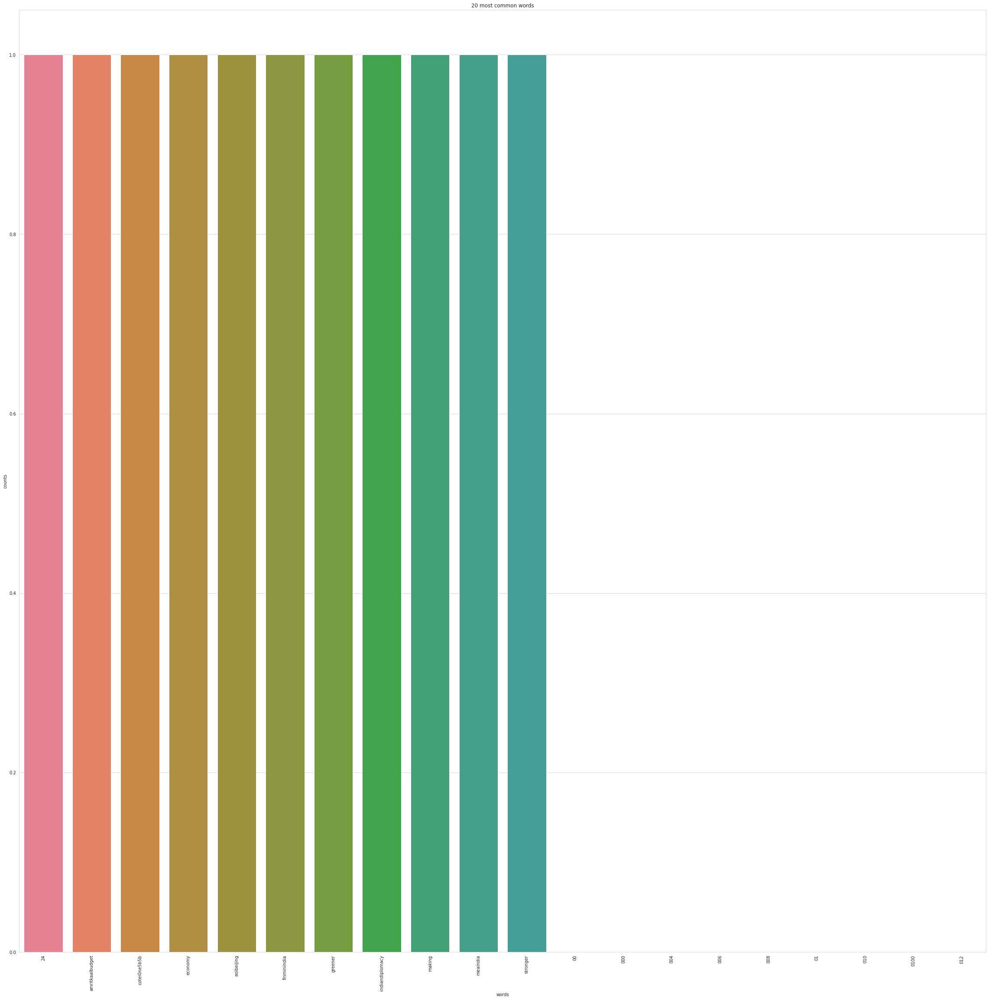

<Figure size 432x288 with 0 Axes>

In [ ]:
sns.set_style('whitegrid')
%matplotlib inline
stop=stop+['budget2023' , 'budget' , 'httpst' , '2023', 'modi' ,'nsitaraman' , 'union', 'pmindia' , 'tax' , 'india']
def plot_20_most_common_words(count_data, count_vectorizer) :
  import matplotlib. pyplot as plt
  words = count_vectorizer.get_feature_names()
  total_counts = np. zeros(len(words))
  for t in count_data:
    total_counts = t.toarray()[0]

  count_dict = (zip(words, total_counts))
  count_dict = sorted(count_dict, key=lambda x:x[1],reverse=True)[0:20]
  words = [w[0] for w in count_dict]
  counts = [w[1] for w in count_dict]
  x_pos = np.arange(len(words))

  plt.figure(2, (40,40))
  plt.subplot(title = '20 most common words')
  sns. set_context('notebook',font_scale=4,rc={ 'lines.linewidth' :2.5})
  sns.barplot(x_pos, counts, palette='husl')
  plt.xticks(x_pos, words, rotation=90)
  plt.xlabel('words')
  plt.ylabel('counts')
  plt.show()

count_vectorizer = CountVectorizer(stop_words=stop)
# Fit and transform the processed titles
count_data = count_vectorizer.fit_transform(df1['renderedContent'])
# print(count_vectorizer)
# print(count_data)
# Visualise the 20 most common words
plot_20_most_common_words(count_data,count_vectorizer)
plt.savefig( 'saved_figure.png')

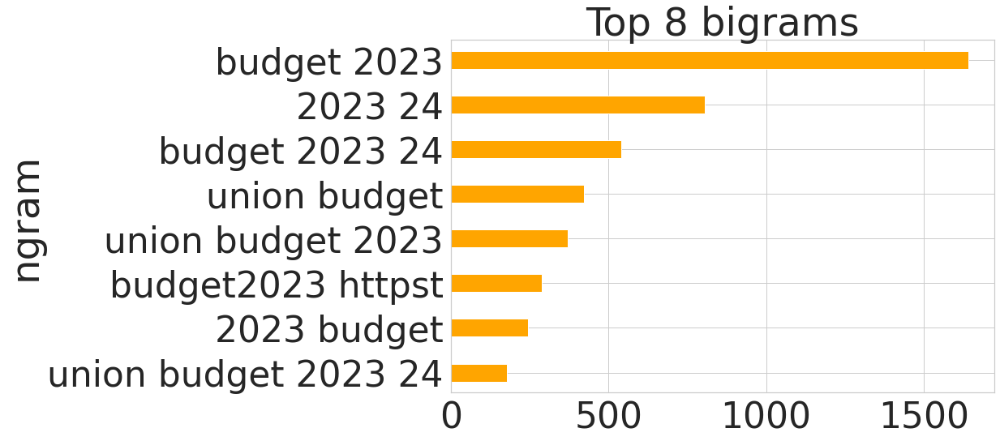

In [ ]:
import cufflinks as cf
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

def get_top_n_bigram(corpus, n=None) :
  vec = CountVectorizer(ngram_range=(2, 4), stop_words="english").fit(corpus)
  bag_of_words = vec.transform(corpus)
  sum_words = bag_of_words.sum(axis=0)
  words_freq =[(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
  words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
  return words_freq[:n]

common_words = get_top_n_bigram(df1['renderedContent'] , 8)
mydict={}
for word, freq in common_words:
  bigram_df = pd.DataFrame(common_words,columns = ['ngram', 'count'])

bigram_df.groupby( 'ngram' ).sum()['count'].sort_values(ascending=False).sort_values().plot.barh(title = 'Top 8 bigrams',color='orange' , width=.4, figsize=(12,8),stacked = True)

In [ ]:
def get_subjectivity(text):
  return TextBlob(text).sentiment.subjectivity
def get_polarity(text):
  return TextBlob(text).sentiment.polarity

In [ ]:
df1['subjectivity']=df1[ 'renderedContent'].apply(get_subjectivity)
df1[ 'polarity' ]=df1[ 'renderedContent'].apply(get_polarity)
df1.head()

,date,rawContent,renderedContent,user,replyCount,retweetCount,likeCount,lang,place,hashtags,viewCount,subjectivity,polarity
0,2023-02-06 23:59:56+00:00,Biden....your budget is due today.\n#budget\n#...,Biden....your budget is due today.\n#budget\n#...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,en,None,"[budget, Budget2023]",11.0,0.375000,-0.125000
1,2023-02-06 23:57:38+00:00,Governor’s 2023-25 Budget Proposal\nhttps://t....,Governor’s 2023-25 Budget Proposal\nbit.ly3DLJ...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,es,None,None,94.0,0.000000,0.000000
2,2023-02-06 23:56:40+00:00,Have you been following #Colwood Council budge...,Have you been following #Colwood Council budge...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,1,1,en,None,[Colwood],295.0,0.208333,0.041667
3,2023-02-06 23:56:19+00:00,Will @CanadianPM @JustinTrudeau and his https:...,Will @CanadianPM @JustinTrudeau and his canada...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,3,en,None,"[FundTheFramework, diabetes, Budget2023, cdnpo...",72.0,0.100000,0.000000
4,2023-02-06 23:54:09+00:00,15 Best Automatic Watches for Every Style and ...,15 Best Automatic Watches for Every Style and ...,"{'_type': 'snscrape.modules.twitter.User', 'us...",0,0,0,en,None,None,NaN,0.300000,1.000000


**5. Sentiment Analysis**

In [ ]:
df1['textblob_score'] =df1[ 'renderedContent'].apply(lambda x: TextBlob(x).sentiment.polarity)

In [ ]:
neutral_threshold=0.05

In [ ]:

df1['textblob_sentiment']=df1[ 'textblob_score'].apply(lambda c:'positive' if c >= neutral_threshold else ('Negative' if c <= -(neutral_threshold) else 'Neutral' ) )

In [ ]:
textblob_df =  df1[['renderedContent','textblob_sentiment','likeCount']]
textblob_df

,renderedContent,textblob_sentiment,likeCount
0,Biden....your budget is due today.\n#budget\n#...,Negative,0
1,Governor’s 2023-25 Budget Proposal\nbit.ly3DLJ...,Neutral,0
2,Have you been following #Colwood Council budge...,Neutral,1
3,Will @CanadianPM @JustinTrudeau and his canada...,Neutral,3
4,15 Best Automatic Watches for Every Style and ...,positive,0
...,...,...,...
4784,Budget gives middle class a little relief.\n#g...,Negative,0
4785,Kya mila logo ko\n#Budget2023\nfb.watchiuY9oLa...,Neutral,0
4786,2023 ಬಜೆಟ್ ವಿಶ್ಲೇಷಣೆ ಸಂವಾದ ಕಾರ್ಯಕ್ರಮಕ್ಕೆ ಮಂಗಳೂ...,Neutral,15
4787,Has any media published a table items cheape...,positive,0


In [ ]:
textblob_df["textblob_sentiment"].value_counts()

Neutral     2856
positive    1513
Negative     420
Name: textblob_sentiment, dtype: int64

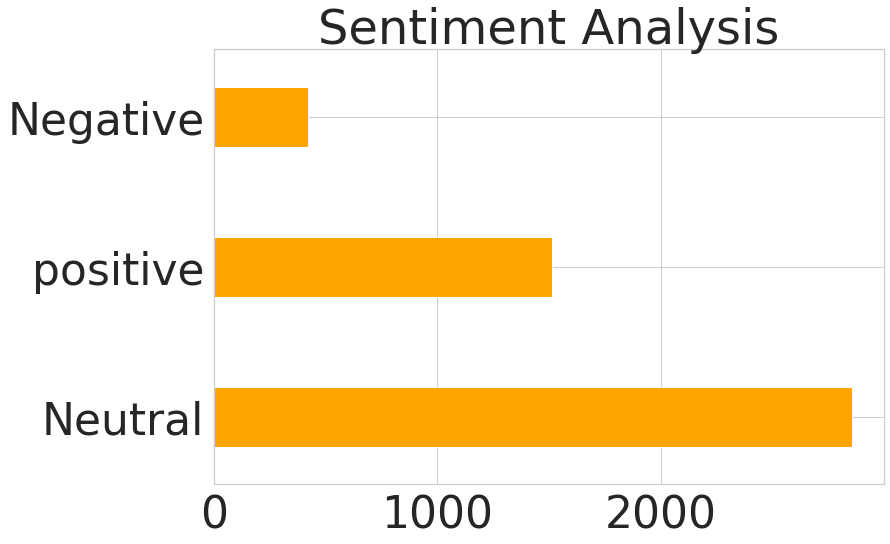

In [ ]:
textblob_df["textblob_sentiment"].value_counts().plot.barh(title = 'Sentiment Analysis',color='orange' , width=.4, figsize=(12,8),stacked = True)

In [ ]:
df_positive=textblob_df[textblob_df['textblob_sentiment']=='positive' ]

In [ ]:
df_very_positive=df_positive[df_positive['likeCount']>0]

In [ ]:
df_very_positive.head()

,renderedContent,textblob_sentiment,likeCount
5,@HStefansonMB @fordnation @RanjPillai1 Let's r...,positive,1
6,@LeagueOfLegends Biggest budget and transparen...,positive,1
17,By investing in affordable reliable #internet...,positive,1
22,Where you live should not determine whether yo...,positive,1
40,RAP Stage II\n• Applications are now invited f...,positive,1


In [ ]:
df_negative=textblob_df[textblob_df['textblob_sentiment']=='Negative' ]

In [ ]:
df_negative

,renderedContent,textblob_sentiment,likeCount
0,Biden....your budget is due today.\n#budget\n#...,Negative,0
30,Union Budget 2023 Middle-class thrust that lar...,Negative,0
38,@GovBillLee #WelfareState \n2022-2023 TENNESSE...,Negative,0
44,$70 per barrel for Urals. The current price is...,Negative,15
45,#Russia_Sanctions Some bad news on oil revenue...,Negative,47
...,...,...,...
4734,Budget 2023-24 Decoding The Government’s Artif...,Negative,1
4755,#Budget2023 focuses on growth but not at the e...,Negative,2
4764,Why did the budget cross the road To get to th...,Negative,1
4774,The Union Budget FY 2023-24 Vision 'Amrit Kaal...,Negative,14


In [ ]:
df_neutral=textblob_df[textblob_df['textblob_sentiment']=='Neutral' ]

In [ ]:
df_neutral

,renderedContent,textblob_sentiment,likeCount
1,Governor’s 2023-25 Budget Proposal\nbit.ly3DLJ...,Neutral,0
2,Have you been following #Colwood Council budge...,Neutral,1
3,Will @CanadianPM @JustinTrudeau and his canada...,Neutral,3
10,"This evening, our President CEO, @gregorydunn...",Neutral,7
14,Ukraine Invasion Russia has been selling forei...,Neutral,0
...,...,...,...
4782,'Putting Budget 2023 into perspective'\n-Analy...,Neutral,31
4783,"આત્મનિર્ભર અને સ્થાયી વિકાસને પોષતું, ભારતને વ...",Neutral,15
4785,Kya mila logo ko\n#Budget2023\nfb.watchiuY9oLa...,Neutral,0
4786,2023 ಬಜೆಟ್ ವಿಶ್ಲೇಷಣೆ ಸಂವಾದ ಕಾರ್ಯಕ್ರಮಕ್ಕೆ ಮಂಗಳೂ...,Neutral,15


**Create a Word Cloud**

In [ ]:
from wordcloud import WordCloud, STOPWORDS
from PIL import Image

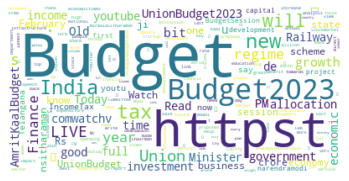

In [ ]:
#Creating the text variable
positive_tw =" ".join(t for t in df_very_positive.renderedContent)
# Creating word _ cloud with text as argument in . generate() rtpthod
word_cloud1 = WordCloud(collocations = False, background_color = 'white') .generate(positive_tw)
# Display the generated Word Cloud
plt. imshow(word_cloud1, interpolation='bilinear')
plt.axis('off')
plt.show()

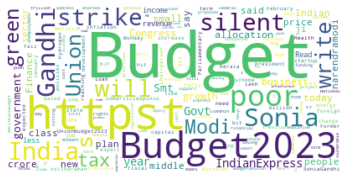

In [ ]:
#Creating the text variable
negative_tw =" ".join(t for t in df_negative.renderedContent)
# Creating word _ cloud with text as argument in . generate() rtpthod
word_cloud2 = WordCloud(collocations = False, background_color = 'white') .generate(negative_tw)
# Display the generated Word Cloud
plt. imshow(word_cloud2, interpolation='bilinear')
plt.axis('off')
plt.show()

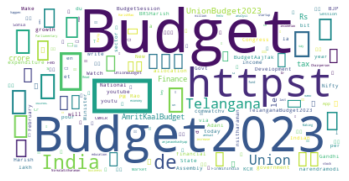

In [ ]:
#Creating the text variable
neutral_tw =" ".join(t for t in df_neutral.renderedContent)
# Creating word _ cloud with text as argument in . generate() rtpthod
word_cloud2 = WordCloud(collocations = False, background_color = 'white') .generate(neutral_tw)
# Display the generated Word Cloud
plt. imshow(word_cloud2, interpolation='bilinear')
plt.axis('off')
plt.show()